In [ ]:
%load_ext autoreload
%autoreload 2

from simformer import GalaxyPrior, GalaxySimulator, GalaxyPhotometryTask
import torch
import jax
import jax.numpy as jnp
import numpy as np
from typing import List, Dict, Tuple, Callable, Type, Union # For GalaxySimulator type hints
from omegaconf import OmegaConf # To create DictConfig-like objects if needed
from scoresbibm.tasks.base_task import InferenceTask 
from scoresbibm.methods.score_transformer import train_transformer_model 
from scoresbibm.methods.models import AllConditionalScoreModel 
from synthesizer.emission_models import PacmanEmission, TotalEmission, EmissionModel, IntrinsicEmission
from synthesizer.emission_models.attenuation import PowerLaw, Calzetti2000
from synthesizer.grid import Grid
from synthesizer.parametric import SFH, ZDist # Need concrete SFH, ZDist classes
from synthesizer.parametric import Stars, Galaxy
from synthesizer.instruments import Instrument, FilterCollection, Filter
from synthesizer.parametric import SFH, ZDist
from unyt import Myr, erg, Hz, s, uJy, Jy, yr, unyt_array, unyt_quantity, Msun
from astropy.cosmology import Planck18
import copy
import inspect
from astropy.cosmology import Cosmology, Planck18
import corner 
from scoresbibm.evaluation.eval_task import eval_coverage, eval_negative_log_likelihood, eval_unstructured_task, eval_all_conditional_task, eval_inference_task
from scoresbibm.utils.data_utils import save_model, load_model, save_summary, query


# Example: Define global 'device' if not already defined
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



### Setup synthesizer

In [4]:
grid_dir = '/home/tharvey/work/synthesizer_grids/' 
grid_name = 'bpass-2.2.1-bin_chabrier03-0.1,300.0_cloudy-c23.01-sps.hdf5'

grid = Grid(grid_name, grid_dir=grid_dir)
filter_codes = ["JWST/NIRCam.F090W","JWST/NIRCam.F115W","JWST/NIRCam.F150W","JWST/NIRCam.F162M",
                "JWST/NIRCam.F182M","JWST/NIRCam.F200W","JWST/NIRCam.F210M","JWST/NIRCam.F250M",
                "JWST/NIRCam.F277W","JWST/NIRCam.F300M","JWST/NIRCam.F335M","JWST/NIRCam.F356W",
                "JWST/NIRCam.F410M","JWST/NIRCam.F444W"]
filterset = FilterCollection(filter_codes)
instrument = Instrument('JWST', filters=filterset)


emission_model_instance = TotalEmission(
    grid=grid, fesc=0.0, fesc_ly_alpha=0.1, dust_curve=Calzetti2000(), dust_emission_model=None,
)

### Setup simulator for photometry and prior ranges

In [ ]:
sfh_model_class = SFH.LogNormal 
zdist_model_class = ZDist.DeltaConstant

emitter_params_dict = {'stellar':['tau_v']}

galaxy_simulator_instance = GalaxySimulator(
    sfh_model=sfh_model_class,
    zdist_model=zdist_model_class,
    grid=grid,
    instrument=instrument,
    emission_model=emission_model_instance,
    emission_model_key='total',
    emitter_params=emitter_params_dict,
    param_units = {'peak_age':Myr, 'max_age':Myr}, 
    normalize_method=None,
    output_type='photo_fnu',
    out_flux_unit='ABmag',
)

inputs_list = ['redshift', 'log_mass', 'log10metallicity', 'tau_v', 'peak_age', 'max_age', 'tau']

priors_ranges_dict = {
    'redshift': (5.0, 12.0), 'log_mass': (7.0, 11.0), 'log10metallicity': (-3.0, -1.3),
    'tau_v': (0.0, 2), 'peak_age': (0.0, 500.0), 
    'max_age': (500.0, 1000.0), 'tau': (0.3, 1.5)
}


### Setup simulator wrapper

In [6]:
def run_simulator_glob(params, return_type='tensor'):
    if isinstance(params, torch.Tensor): params = params.cpu().numpy()
    if isinstance(params, dict): pass # assumes params are correctly keyed
    elif isinstance(params, (list, tuple, np.ndarray)):
        params = np.squeeze(params)
        params = {inputs_list[i]: params[i] for i in range(len(inputs_list))}

    phot = galaxy_simulator_instance(params) # This line requires galaxy_simulator_instance

    if return_type == 'tensor':
        return torch.tensor(phot[np.newaxis, :], dtype=torch.float32).to(device)
    else:
        return phot


galaxy_task = GalaxyPhotometryTask(
    prior_dict=priors_ranges_dict,
    param_names_ordered=inputs_list,
    run_simulator_fn=run_simulator_glob, # Pass your actual function
    num_filters=len(filter_codes)
)

# Test data generation
print(f"Theta dim: {galaxy_task.get_theta_dim()}")
print(f"X dim: {galaxy_task.get_x_dim()}")
data_batch = galaxy_task.get_data(num_samples=3)
print("Sampled theta (JAX):", data_batch["theta"])
print("Shape of theta:", data_batch["theta"].shape)
print("Sampled x (JAX):", data_batch["x"])
print("Shape of x:", data_batch["x"].shape)

# Test prior sampling directly
prior_for_test = galaxy_task.get_prior()
theta_samples_torch = prior_for_test.sample((2,))
print("Direct prior samples (Torch):", theta_samples_torch)
print("Log prob of prior samples:", prior_for_test.log_prob(theta_samples_torch))

# Test base mask function
mask_fn = galaxy_task.get_base_mask_fn()
node_ids_example = jnp.arange(galaxy_task.get_theta_dim() + galaxy_task.get_x_dim())
# jax.random.shuffle(jax.random.PRNGKey(0), node_ids_example) # Example of permuted IDs
applied_mask = mask_fn(node_ids=node_ids_example, node_meta_data=None)
print("Base mask applied to node_ids:", applied_mask)


Theta dim: 7
X dim: 14
Sampled theta (JAX): [[  6.717  10.939  -2.764   0.784 448.936 777.003   0.631]
 [ 11.279   9.917  -2.456   0.489 286.449 593.382   0.712]
 [  9.515   9.841  -1.842   0.884  53.658 896.63    0.506]]
Shape of theta: (3, 7)
Sampled x (JAX): [[ 26.649  25.182  24.936  24.889  24.818  24.702  24.6    24.424  24.072
   23.719  23.497  23.151  23.081  23.128]
 [238.792  75.035  27.954  27.22   27.142  27.093  27.053  27.004  26.978
   26.964  26.796  26.8    26.718  26.459]
 [ 59.219  32.172  28.196  28.117  27.882  27.803  27.74   27.61   27.492
   27.39   27.259  27.098  26.667  26.58 ]]
Shape of x: (3, 14)
Direct prior samples (Torch): tensor([[ 6.8657e+00,  9.0612e+00, -1.6893e+00,  7.8214e-01,  4.9860e+02,
          7.4807e+02,  9.3169e-01],
        [ 1.0711e+01,  7.3857e+00, -2.2921e+00,  1.9955e+00,  3.6845e+02,
          5.0189e+02,  6.1573e-01]])
Log prob of prior samples: tensor([-17.1675, -17.1675])


/home/tharvey/work/simformer/simformer_venv/lib/python3.11/site-packages/unyt/array.py:1832: RuntimeWarning: divide by zero encountered in log10
  out_arr = func(np.asarray(inp), out=out_func, **kwargs)
/home/tharvey/work/synthesizer/src/synthesizer/emission_models/transformers/igm.py:422: RuntimeWarning: overflow encountered in exp
  transmission = np.exp(-tau)


Base mask applied to node_ids: [[ True False False False False False False False False False False False
  False False False False False False False False False]
 [False  True False False False False False False False False False False
  False False False False False False False False False]
 [False False  True False False False False False False False False False
  False False False False False False False False False]
 [False False False  True False False False False False False False False
  False False False False False False False False False]
 [False False False False  True False False False False False False False
  False False False False False False False False False]
 [False False False False False  True False False False False False False
  False False False False False False False False False]
 [False False False False False False  True False False False False False
  False False False False False False False False False]
 [ True  True  True  True  True  True  True  True Fa

### Configure model hyperparameters


In [10]:
# Model Configuration (from config/method/model/score_transformer.yaml)
#
model_config_dict = {
    "name": "ScoreTransformer",
    "d_model": 128,
    "n_heads": 4,
    "n_layers": 4,
    "d_feedforward": 256,
    "dropout": 0.1,
    "max_len": 5000, # Adjust based on theta_dim + x_dim
    "tokenizer": {"name": "LinearTokenizer", "encoding_dim": 64},
    "use_output_scale_fn": True, 
    # Add other model-specific parameters as per the YAML
    }

# SDE Configuration (e.g., from config/method/sde/vpsde.yaml)
#
sde_config_dict = {
    "name": "VPSDE", # or "VESDE"
    "beta_min": 0.1,
    "beta_max": 20.0,
    "num_steps": 1000,
    'T_min': 1e-05, 
    'T_max': 1.0,
}

# Training Configuration (from config/method/train/train_score_transformer.yaml)
train_config_dict = {
    "learning_rate": 1e-4, # Initial learning rate for training # used
    "min_learning_rate": 1e-6, # Minimum learning rate for training # used
    #"optimizer": {"name": "Adam", "beta1": 0.9, "beta2": 0.999, "eps": 1e-8, "weight_decay": 0.0},
    "z_score_data": True, # Whether to z-score (normalize) the data # used
    "total_number_steps_scaling":5, # Scaling factor for total number of steps # used
    "max_number_steps": 1e8, # Maximum number of steps for training # used
    "min_number_steps": 1e4, # Minimum number of steps for training # used
    "training_batch_size": 64, # Batch size for training # used
    "val_every": 50, # Validate every 100 steps # used
    "clip_max_norm": 10.0, # Gradient clipping max norm # used
    "condition_mask_fn": {'name': 'structured_random'}, # Use the base mask function defined in the task
    "edge_mask_fn": {'name': 'faithfull'}, 
    "validation_fraction": 0.1, # Fraction of data to use for validation # used
    "val_repeat": 5, # Number of times to repeat validation # used
    "stop_early_count":5, # Number of steps to wait before stopping early # used
    "rebalance_loss": True, # Whether to rebalance the loss # used
}


method_config_dict = {
    "device": str(device), # Ensure this matches your device setup
    "sde": sde_config_dict,
    "model": model_config_dict,
    "train": train_config_dict,
    # Add any other top-level parameters from method YAML files if they exist and are used.
}

# Convert the main method_cfg to OmegaConf DictConfig
method_cfg = OmegaConf.create(method_config_dict)


In [68]:
galaxy_task.get_data(num_samples=3)

{'theta': Array([[  9.013,  10.173,  -2.959,   1.422, 493.951, 612.266,   0.615],
        [  7.534,   8.946,  -2.179,   0.015, 129.261, 566.536,   0.731],
        [  6.752,   8.083,  -2.454,   0.058, 258.384, 855.562,   1.442]],      dtype=float32),
 'x': Array([[53.881, 32.783, 30.512, 30.313, 30.055, 29.911, 29.813, 29.503,
         29.2  , 28.973, 28.657, 28.247, 27.431, 27.178],
        [35.349, 27.346, 27.294, 27.314, 27.322, 27.36 , 27.398, 27.375,
         27.368, 27.336, 26.98 , 27.003, 26.441, 26.703],
        [31.208, 29.974, 29.998, 30.025, 30.069, 30.028, 29.982, 30.014,
         29.796, 29.538, 29.52 , 29.115, 29.047, 29.295]], dtype=float32)}

### Setup task and generate training data

In [ ]:
print("Instantiating GalaxyPhotometryTask...")
galaxy_task = GalaxyPhotometryTask(
    prior_dict=priors_ranges_dict,
    param_names_ordered=inputs_list,
    run_simulator_fn=run_simulator_glob, 
    num_filters=len(filter_codes),
    backend="jax" # Or "torch" 
)
print("Task instantiated.")

# --- 2. Generate Data ---
num_training_simulations = 5000 
print(f"Generating {num_training_simulations} training simulations...")
# .get_data() returns a dict with JAX arrays if backend is "jax"
training_data = galaxy_task.get_data(num_samples=num_training_simulations)
theta_train = training_data["theta"]
x_train = training_data["x"]
print(f"Data generated: theta shape {theta_train.shape}, x shape {x_train.shape}")

# (Optional) Generate validation data if your train_config.val_split is 0 
num_validation_simulations = 20
validation_data = galaxy_task.get_data(num_samples=num_validation_simulations)
theta_val = validation_data["theta"]
x_val = validation_data["x"]

# --- 3. Set RNG Seed for JAX ---
rng_seed_for_training = 0 
master_rng_key = jax.random.PRNGKey(rng_seed_for_training)

  

Instantiating GalaxyPhotometryTask...
Task instantiated.
Generating 5000 training simulations...


/home/tharvey/work/synthesizer/src/synthesizer/parametric/stars.py:370: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  sf = integrate.quad(


Data generated: theta shape (5000, 7), x shape (5000, 14)


### Train the model

In [11]:
# --- 4. Train the Model ---

print("Starting training...")
trained_score_model = train_transformer_model(
    task=galaxy_task,
    data=training_data, # Expects dict {"theta": ..., "x": ...} with JAX arrays
    method_cfg=method_cfg,       # The OmegaConf object created above
    rng=master_rng_key
)
print("Training finished. Model returned by train_transformer_model:", type(trained_score_model))


Starting training...
Train loss:  1.2888583
Train loss:  0.17688893
Validation loss:  0.15029618 0
Train loss:  0.16260922
Validation loss:  0.14421907 0
Train loss:  0.1469614
Validation loss:  0.14203234 0
Train loss:  0.13050987
Validation loss:  0.19041592 1
Train loss:  0.12565738
Validation loss:  0.13489929 0
Train loss:  0.12208246
Validation loss:  0.14265746 1
Train loss:  0.10931591
Validation loss:  0.11851272 0
Train loss:  0.11303601
Validation loss:  0.11284316 0
Train loss:  0.12902191
Validation loss:  0.11629087 0
Training finished. Model returned by train_transformer_model: <class 'scoresbibm.methods.models.AllConditionalScoreModel'>


### Evaluate and validate the model

'\nimport pickle\nwith open("trained_galaxy_score_model_params.pkl", "wb") as f:\n    pickle.dump(trained_score_model.score_model_params, f)\nprint("Model parameters saved (example).")'

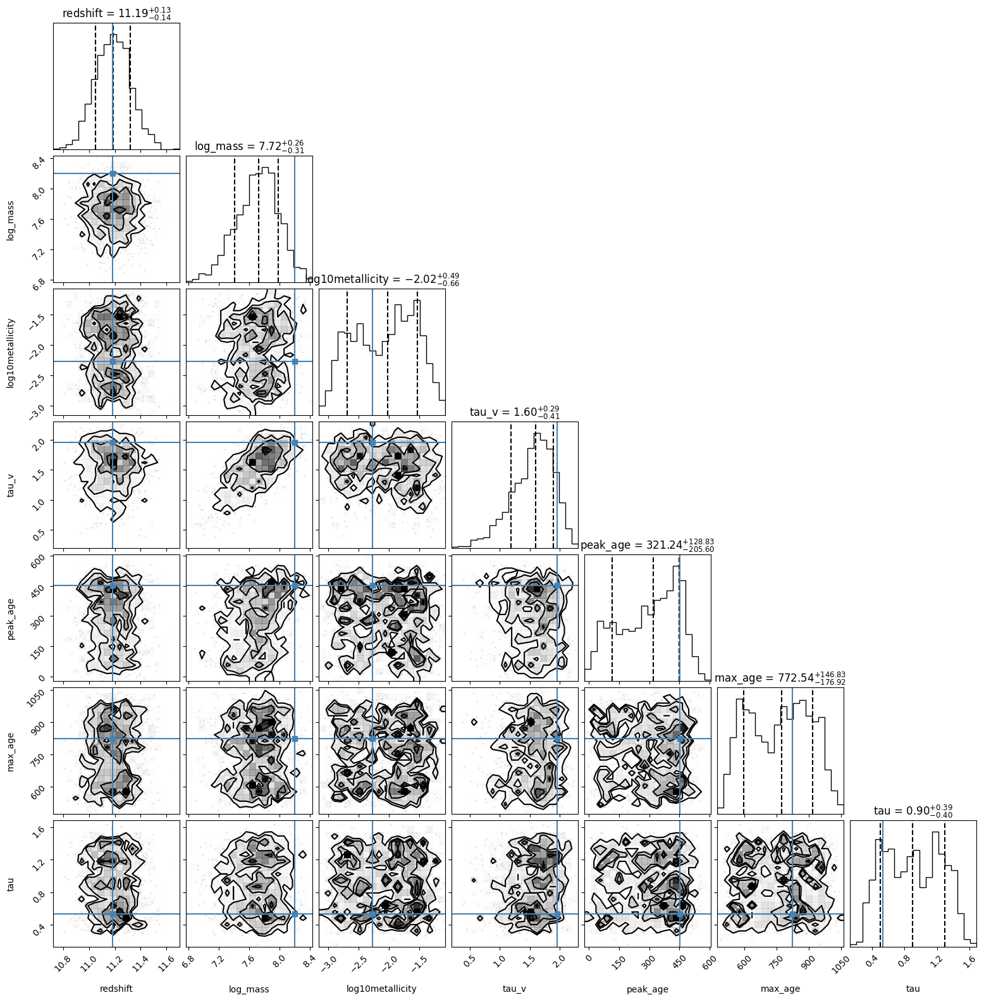

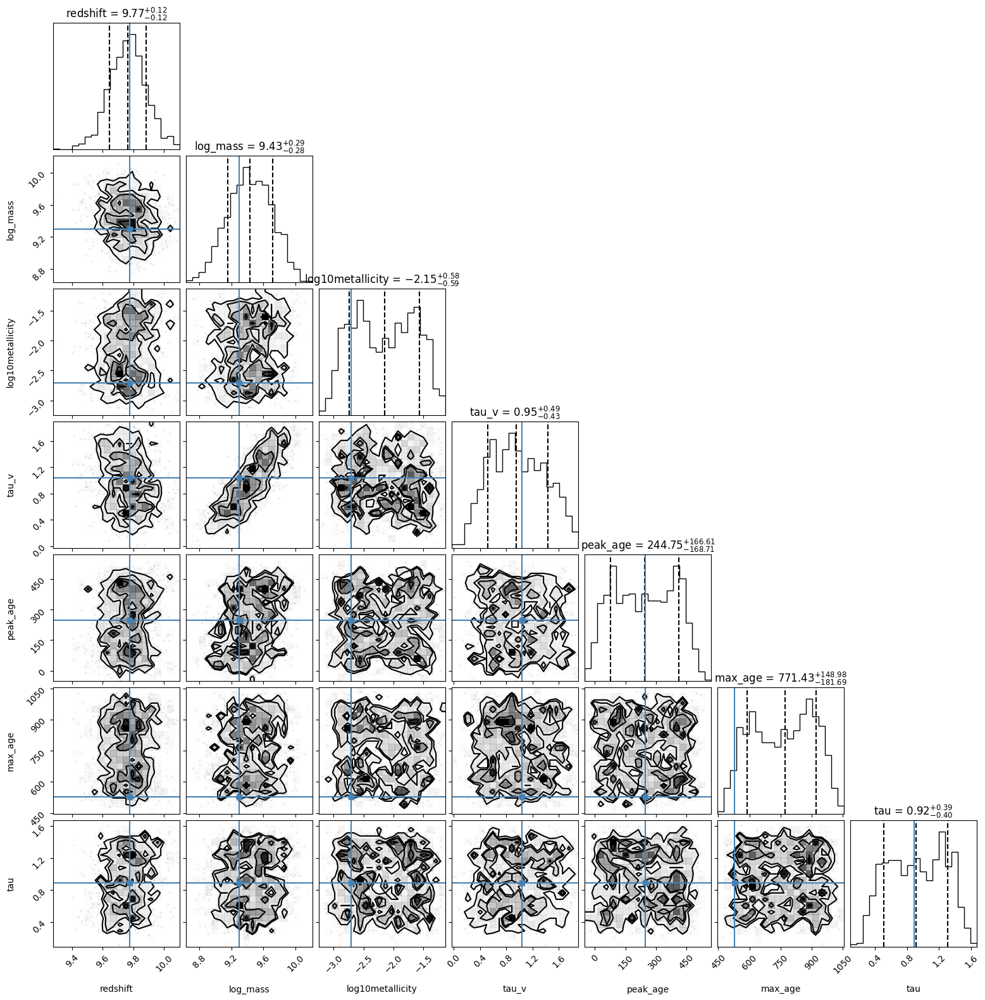

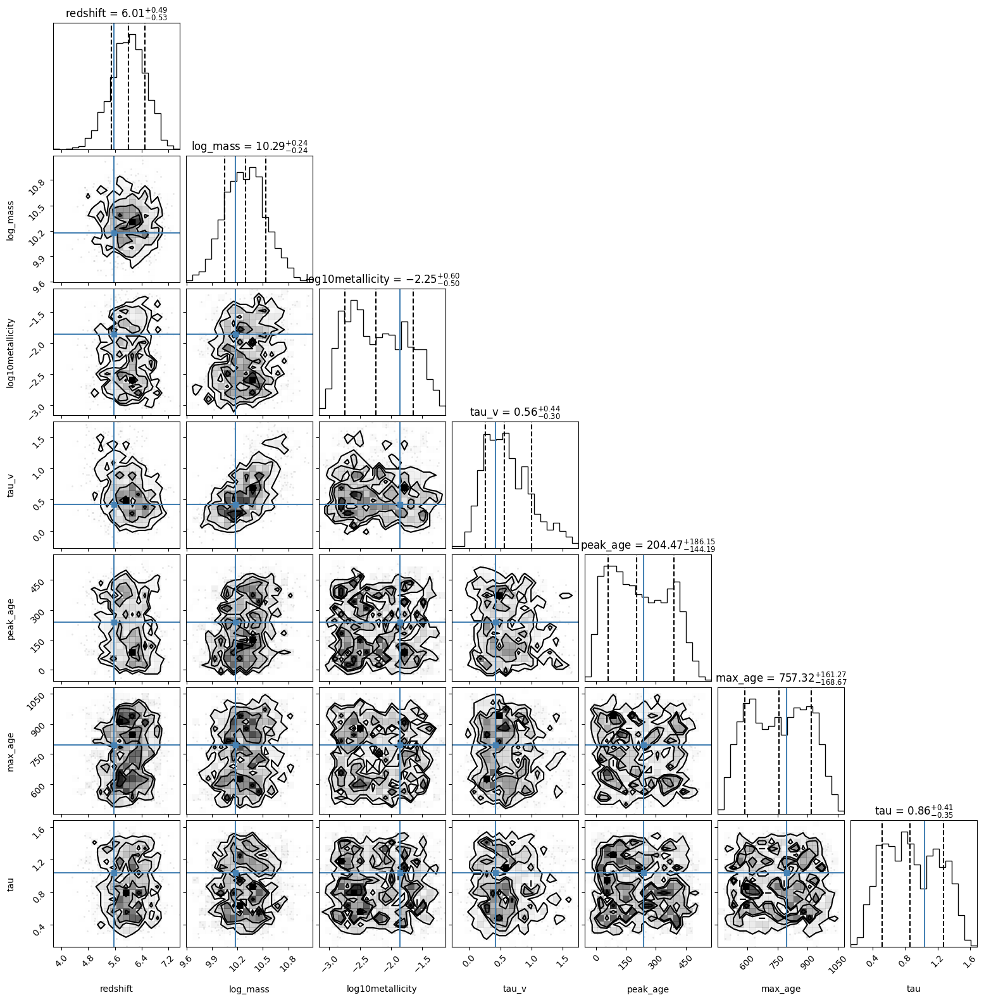

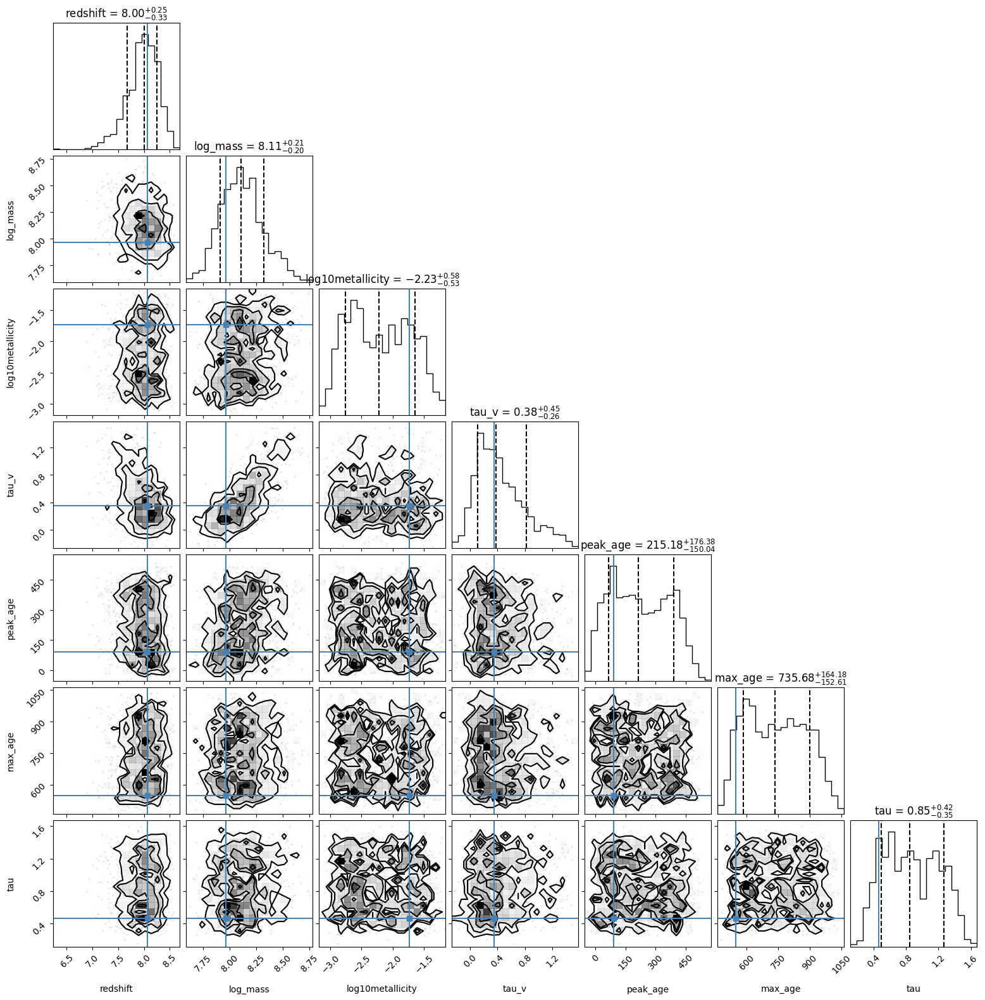

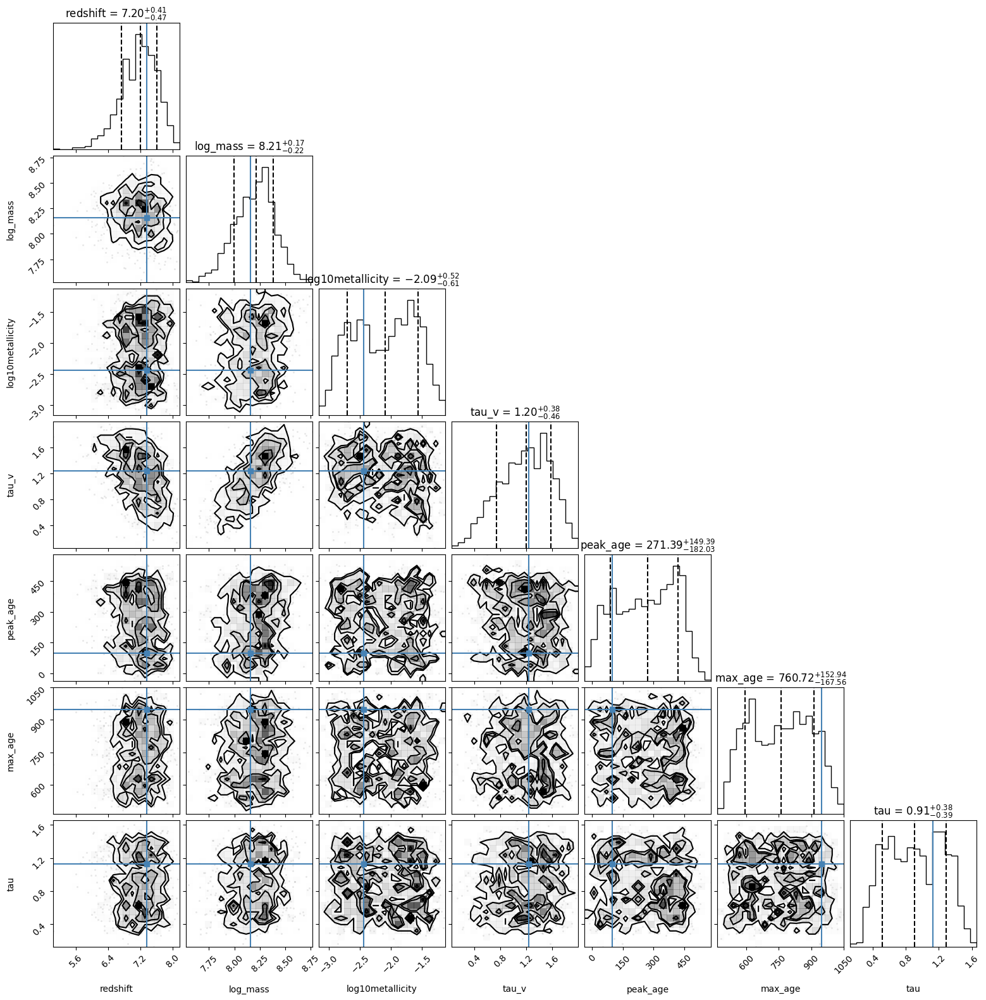

...

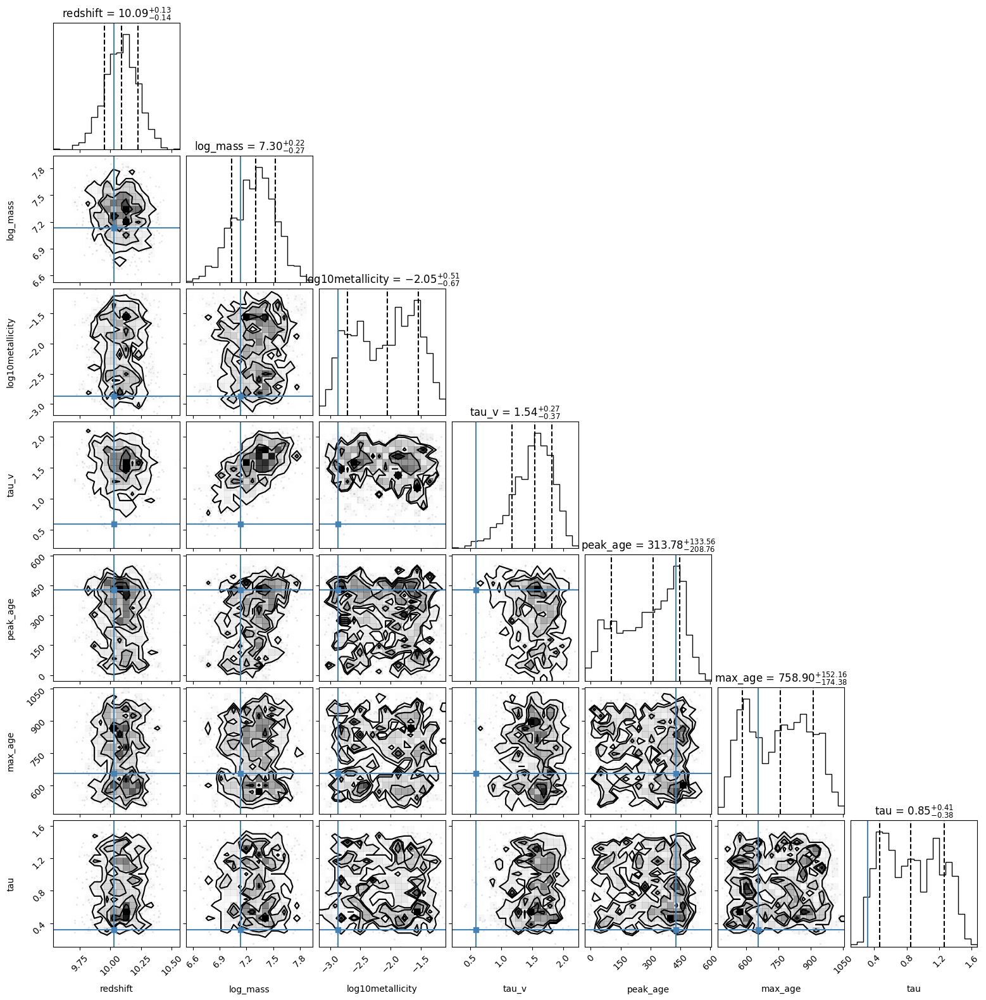

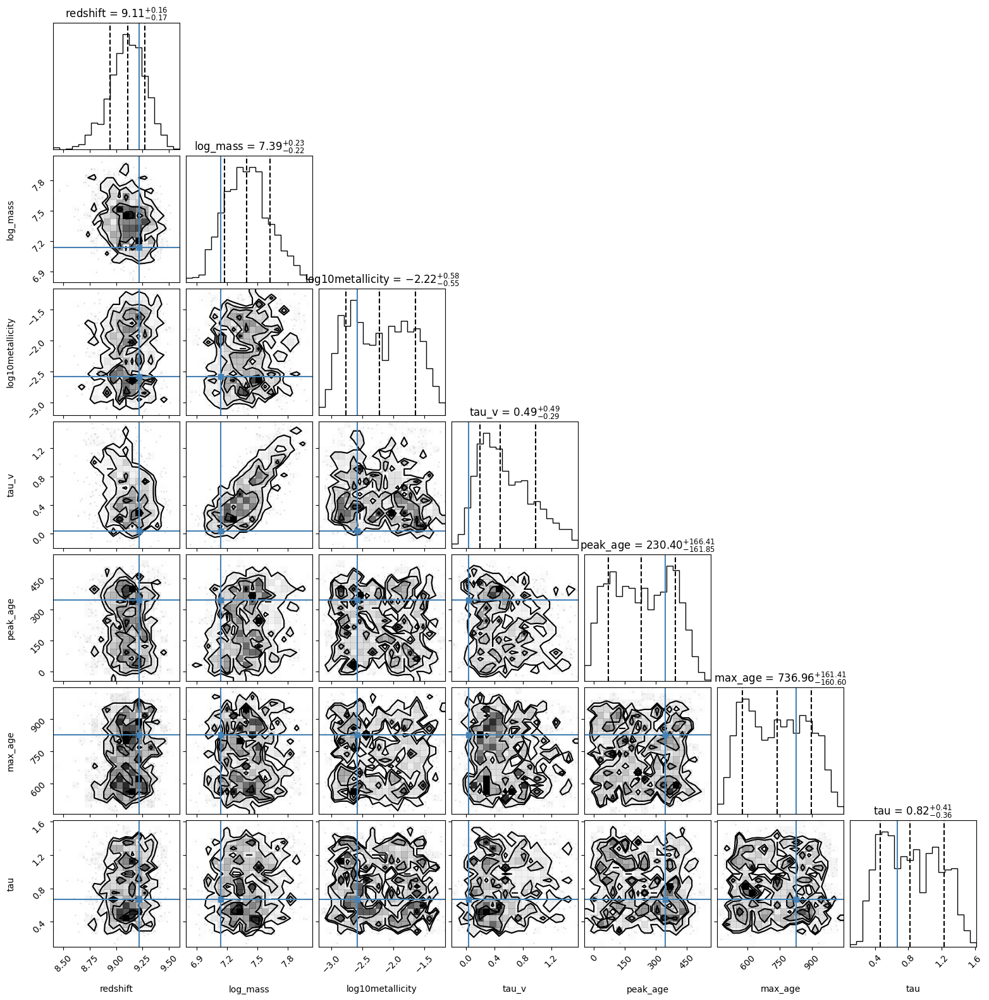

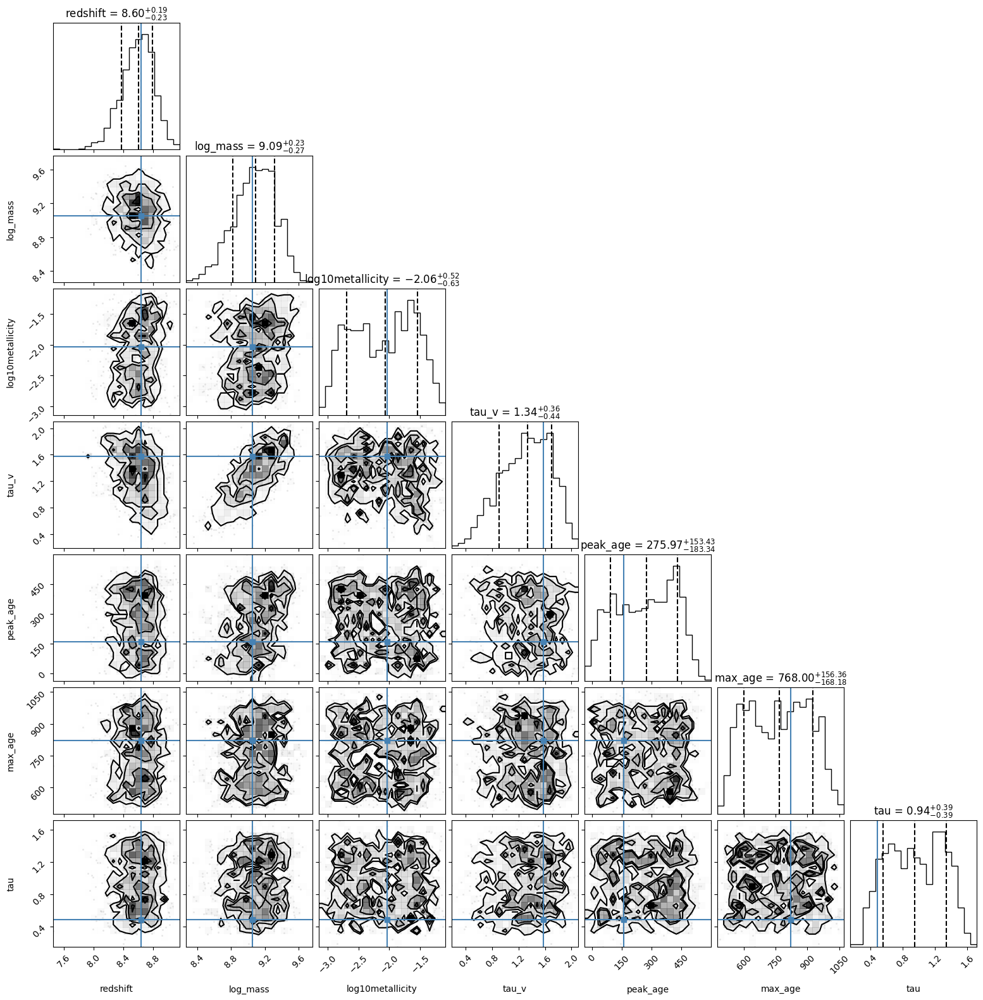

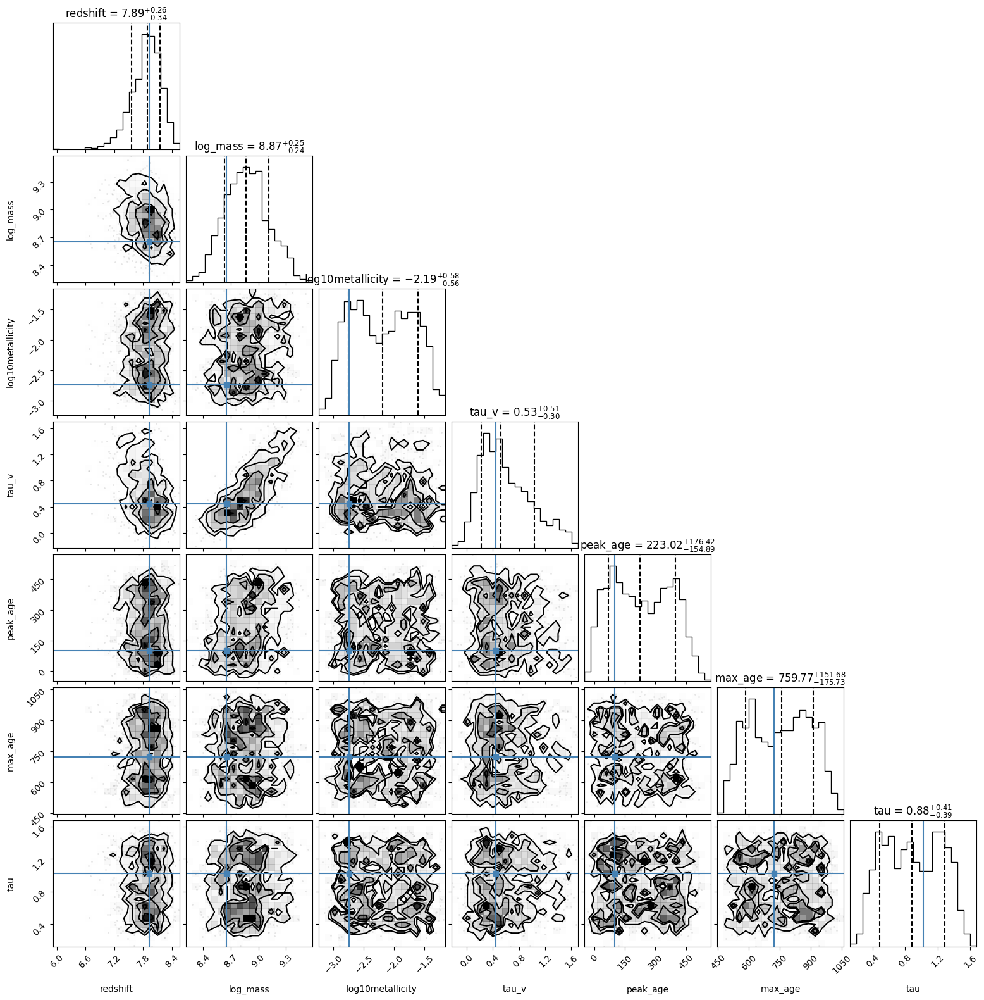

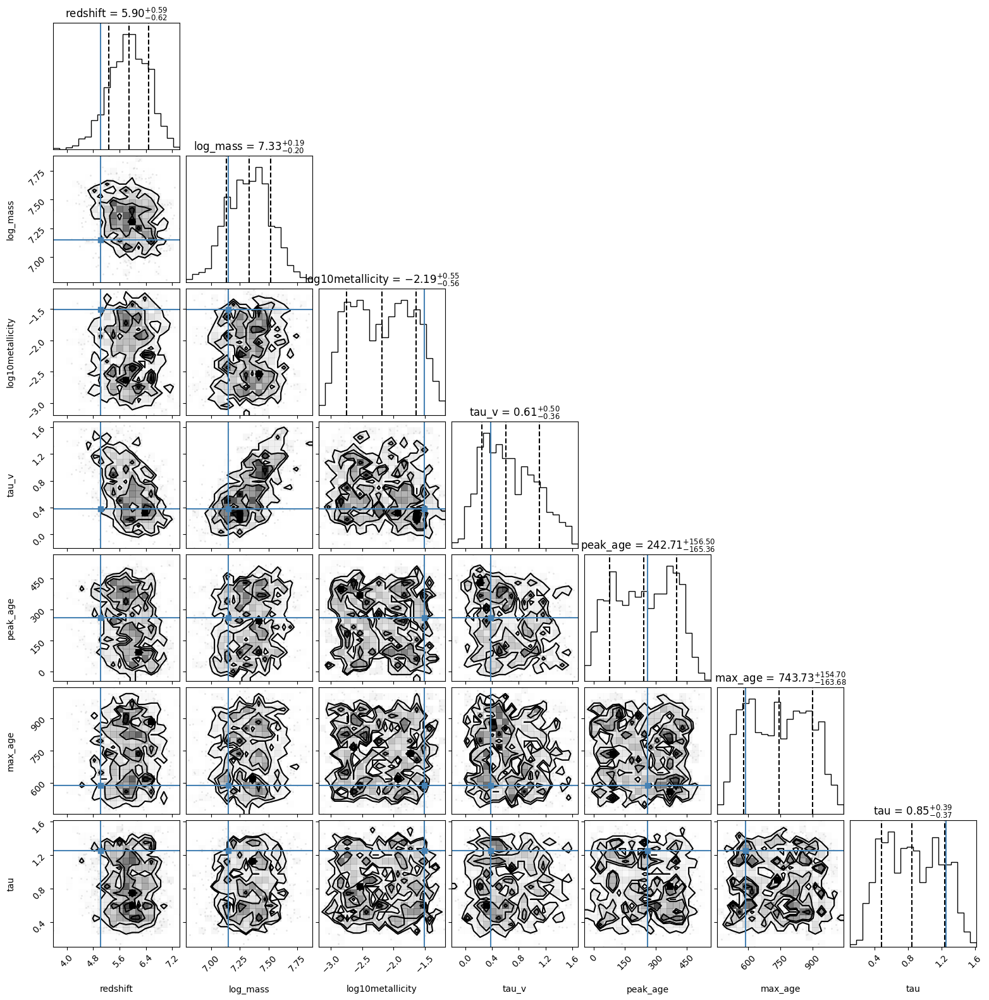

In [12]:
plot_corner = True
import corner
import matplotlib.pyplot as plt
# Take test observation
theta_dim = galaxy_task.get_theta_dim()
x_dim = galaxy_task.get_x_dim()
# Mask for posterior: theta is unknown (0), x is known (1)
posterior_condition_mask = jnp.array([0]*theta_dim + [1]*x_dim, dtype=jnp.bool_)
for i, xobs in enumerate(x_val):
    x_o = jnp.array([xobs], dtype=jnp.float32)
    samples = trained_score_model.sample_batched(num_samples=1000,
                                                    x_o=x_o, rng=master_rng_key,
                                                    condition_mask=posterior_condition_mask)
    samples = np.array(samples, dtype=np.float32)
    theta = np.array(theta_val[i], dtype=np.float32)

    if plot_corner:
        truth = np.array(theta_val[i], dtype=np.float32)

        corner.corner(samples, labels=galaxy_task.param_names_ordered, show_titles=True,
                        truths=truth, quantiles=[0.16, 0.5, 0.84], title_kwargs={"fontsize": 12})
        plt.savefig(f"/home/tharvey/work/ltu-ili_testing/models/simformer/plots/corner_plot_{i}.png")
'''
import pickle
with open("trained_galaxy_score_model_params.pkl", "wb") as f:
    pickle.dump(trained_score_model.score_model_params, f)
print("Model parameters saved (example).")'''

### Compute C2ST metric

In [ ]:
from socresbim.evaluation.eval_metrics import c2st

eval_inference_task(
    task=galaxy_task,
    model=trained_score_model,
    metric_function=c2st,  # Use the c2st metric function
    metric_params={},
    rng_eval=master_rng_key,
    num_samples=1000,
    num_evaluations= 10)


In [13]:

def get_condition_mask_fn(str):
    return galaxy_task.get_base_mask_fn() if str == 'base' else galaxy_task.get_joint_mask_fn()

metric_values, eval_time = eval_coverage(
    task=galaxy_task,
    model=trained_score_model,
    metric_params={
        'num_samples': 1000,  # Number of samples to draw for coverage evaluation
        'num_evaluations': 50,
        'condition_mask_fn': 'posterior',  # posterior, joint, likelihood, random or structured random
        'num_bins': 20,  # Number of bins for histogram
        'sample_kwargs': {},
        'log_prob_kwargs': {},
        'batch_size': 64,  # Batch size for sampling
    },
    rng=master_rng_key

)

/home/tharvey/work/simformer/simformer_venv/lib/python3.11/site-packages/unyt/array.py:1832: RuntimeWarning: divide by zero encountered in log10
  out_arr = func(np.asarray(inp), out=out_func, **kwargs)
/home/tharvey/work/synthesizer/src/synthesizer/emission_models/transformers/igm.py:422: RuntimeWarning: overflow encountered in exp
  transmission = np.exp(-tau)


Finished sampling for batch  0
Finished sampling for batch  1
Finished sampling for batch  2
Finished sampling for batch  3
Finished sampling for batch  4
Finished sampling for batch  5
Finished sampling for batch  6
Finished sampling for batch  7
Finished sampling for batch  8
Finished sampling for batch  9
Finished sampling for batch  10
Finished sampling for batch  11
Finished sampling for batch  12
Finished sampling for batch  13
Finished sampling for batch  14
Finished computing true log probs
Finished computing sample log probs for batch  0
Finished computing sample log probs for batch  1
Finished computing sample log probs for batch  2
Finished computing sample log probs for batch  3
Finished computing sample log probs for batch  4
Finished computing sample log probs for batch  5
Finished computing sample log probs for batch  6
Finished computing sample log probs for batch  7
Finished computing sample log probs for batch  8
Finished computing sample log probs for batch  9
Finish

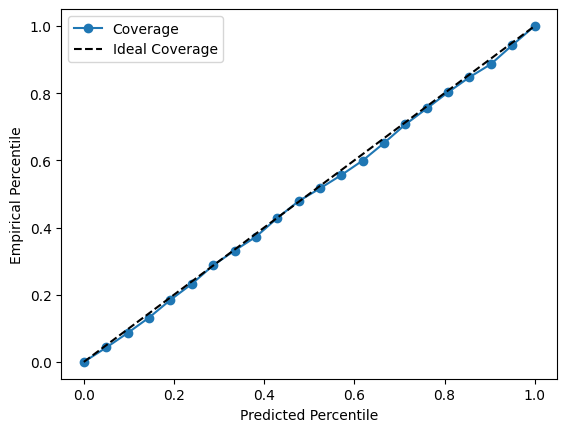

In [69]:
plt.plot(metric_values[0], metric_values[1], marker='o', label='Coverage')
plt.plot([0, 1], [0, 1], 'k--', label='Ideal Coverage')
plt.xlabel('Predicted Percentile')
plt.ylabel('Empirical Percentile')
plt.legend()
plt.savefig('/home/tharvey/work/ltu-ili_testing/models/simformer/plots/coverage_plot.png')

### Saving the model

In [65]:
save_model(
    model=trained_score_model,
    dir_path='/home/tharvey/work/ltu-ili_testing/models/simformer/',
    model_id='simformer_galaxy_score_model_test_v1',

)

# also need to pickle - num_filters, prior_dict, run_simulator_fn, param_names_ordered, backend

save_dict = {
    '_x_dim': galaxy_task.get_x_dim(),
    '_theta_dim': galaxy_task.get_theta_dim(),
    'prior_dict': priors_ranges_dict,
    'param_names_ordered': galaxy_task.param_names_ordered,
    'backend': galaxy_task.backend,
    'method_config_dict': method_config_dict,
    
}

from joblib import dump
dump(save_dict, '/home/tharvey/work/ltu-ili_testing/models/simformer/models/data_simformer_galaxy_score_model_test_v1.joblib')

['/home/tharvey/work/ltu-ili_testing/models/simformer/models/data_simformer_galaxy_score_model_test_v1.joblib']

In [61]:
reloaded_model = load_model(
    dir_path='/home/tharvey/work/ltu-ili_testing/models/simformer/',
    model_id='simformer_galaxy_score_model_test_v1',
)

In [58]:
plot_corner = True
import corner
import matplotlib.pyplot as plt
# Take test observation
theta_dim = galaxy_task.get_theta_dim()
x_dim = galaxy_task.get_x_dim()
# Mask for posterior: theta is unknown (0), x is known (1)
posterior_condition_mask = jnp.array([0]*theta_dim + [1]*x_dim, dtype=jnp.bool_)
for i, xobs in enumerate(x_val):
    x_o = jnp.array([xobs], dtype=jnp.float32)
    samples = trained_score_model.sample_batched(num_samples=1000,
                                                    x_o=x_o, rng=master_rng_key,
                                                    condition_mask=posterior_condition_mask)
    samples = np.array(samples, dtype=np.float32)
    theta = np.array(theta_val[i], dtype=np.float32)

    if plot_corner:
        truth = np.array(theta_val[i], dtype=np.float32)

        corner.corner(samples, labels=galaxy_task.param_names_ordered, show_titles=True,
                        truths=truth, quantiles=[0.16, 0.5, 0.84], title_kwargs={"fontsize": 12})
        plt.savefig(f"/home/tharvey/work/ltu-ili_testing/models/simformer/plots/corner_plot_{i}.png")
'''
import pickle
with open("trained_galaxy_score_model_params.pkl", "wb") as f:
    pickle.dump(trained_score_model.score_model_params, f)
print("Model parameters saved (example).")'''

TypeError: 'NoneType' object is not callable

In [59]:
trained_score_model.z_score_params

{'mean_per_node_id': Array([[  8.5  ],
        [  8.978],
        [ -2.14 ],
        [  0.99 ],
        [249.866],
        [749.968],
        [  0.901],
        [ 88.705],
        [ 45.068],
        [ 30.816],
        [ 30.552],
        [ 30.37 ],
        [ 30.266],
        [ 30.191],
        [ 29.914],
        [ 29.722],
        [ 29.566],
        [ 29.314],
        [ 29.18 ],
        [ 28.889],
        [ 28.711]], dtype=float32),
 'std_per_node_id': Array([[  2.025],
        [  1.147],
        [  0.494],
        [  0.586],
        [145.905],
        [143.289],
        [  0.345],
        [ 86.562],
        [ 22.079],
        [  3.474],
        [  3.389],
        [  3.33 ],
        [  3.3  ],
        [  3.281],
        [  3.248],
        [  3.239],
        [  3.237],
        [  3.213],
        [  3.191],
        [  3.148],
        [  3.105]], dtype=float32),
 'z_score_fn': None,
 'un_z_score_fn': None}